In [2]:
import cv2
import glob
import transformers
import os
import random
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
import numpy as np
import torch
from transformers import pipeline
from IPython.display import display
from skimage.filters import unsharp_mask
import json
import patoolib
import xml.etree.ElementTree as ET
from IPython.display import Video

# Datasets for Detection 

- LLVIP: A Visible-infrared Paired Dataset for Low-light Vision (thermal for object detection)
- FREE Teledyne FLIR Thermal Dataset for Algorithm Training (thermal for object detection)
- KAIST Multispectral Pedestrian Detection Benchmark (thermal for object detection)

In [3]:
COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]

def plot_boxes(ax, labels, boxes):
    colors = COLORS * 100
    for label, (xmin, ymin, xmax, ymax), c  in zip(labels, boxes, colors):
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, fill=False, color=c, linewidth=2))
        ax.text(xmin, ymin, label, fontsize=6, bbox=dict(facecolor='yellow', alpha=0.5))  

### FREE Teledyne FLIR Thermal Dataset for Algorithm Training (thermal for object detection)

In [4]:
def get_annotations(data):
    n = len(data['frames'])
    annotations = {}
    for i in range(n):
        key = data['frames'][i]['datasetFrameId']
        annotations[key] = {'labels' : [], 'boxes' : []}
        for item in data['frames'][i]['annotations']:
            annotations[key]['labels'].append(item['labels'][0])
            box = item['boundingBox']
            x_min = box['x']
            y_min = box['y']
            x_max = x_min + box['w']
            y_max = y_min + box['h']
            annotations[key]['boxes'].append((x_min, y_min, x_max, y_max))
    return annotations

512


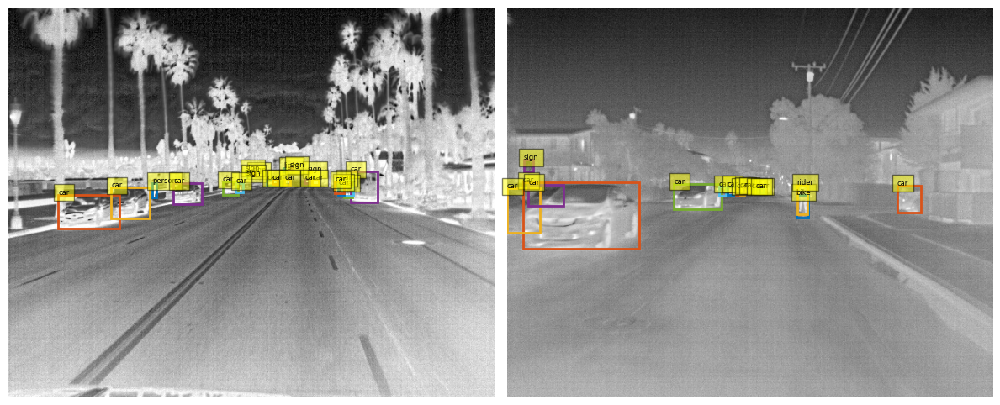

512


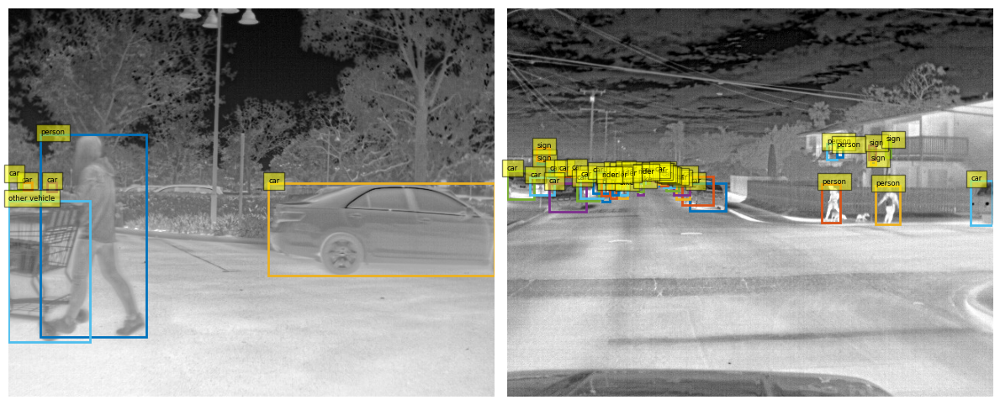

512


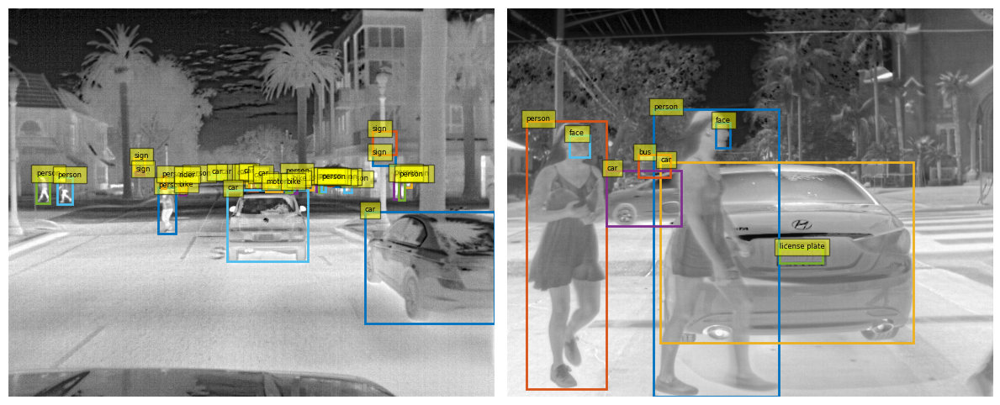

512


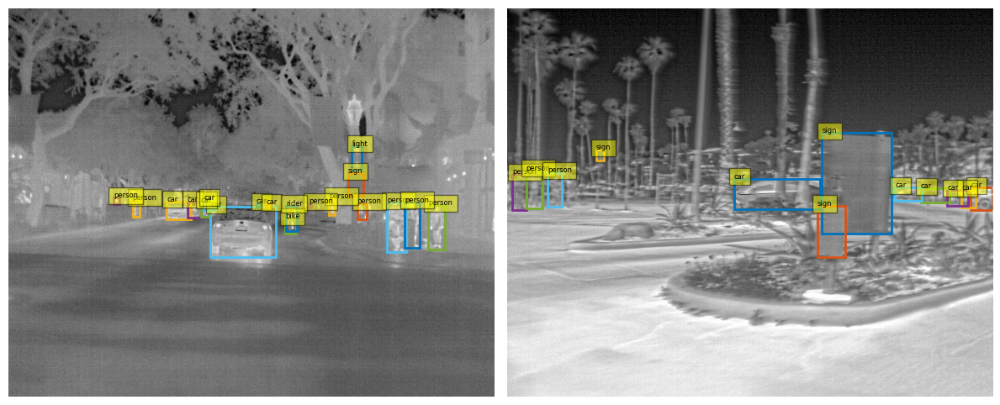

512


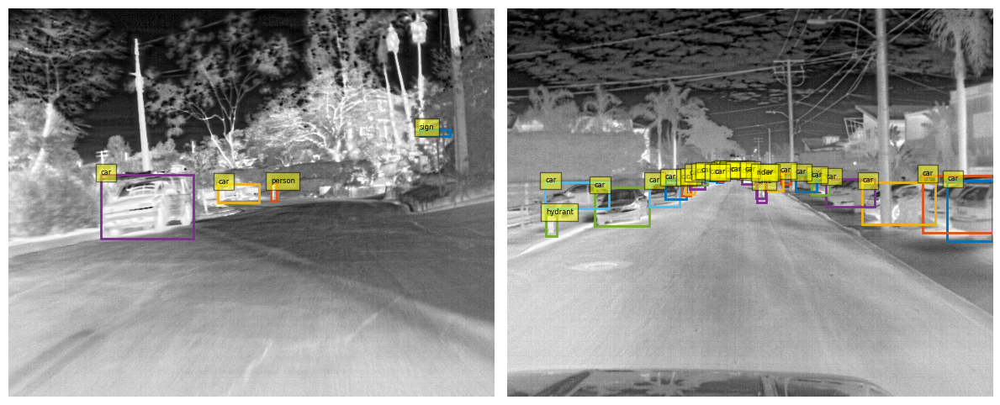

512


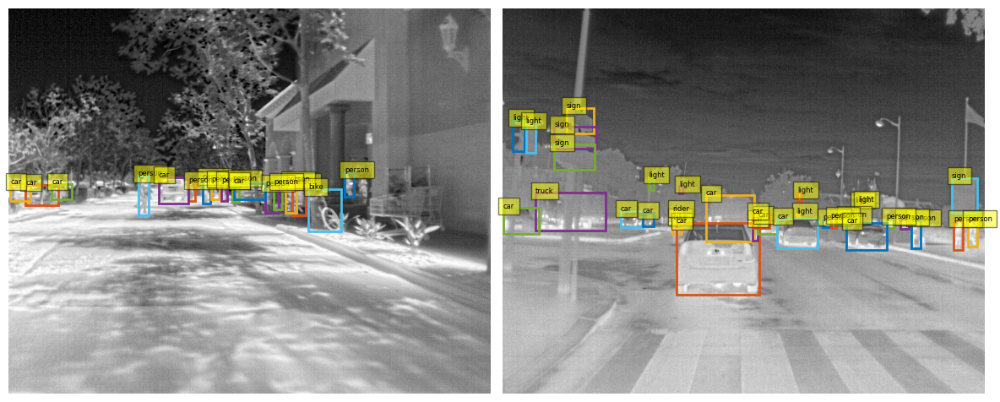

512


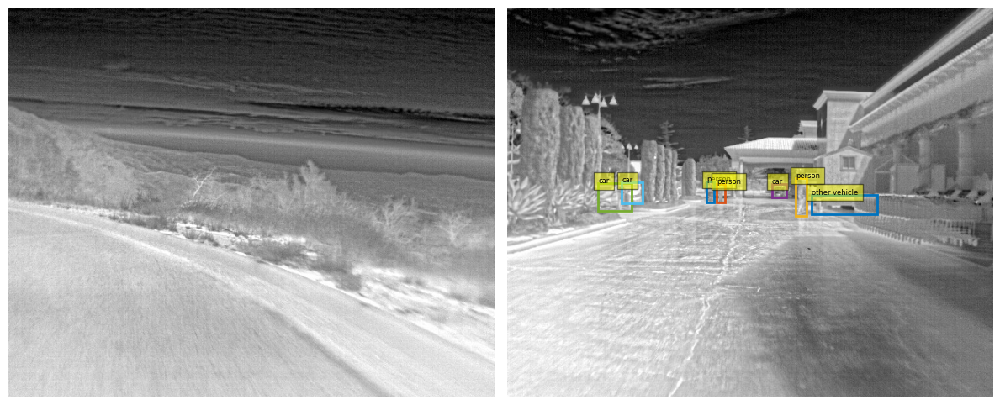

512


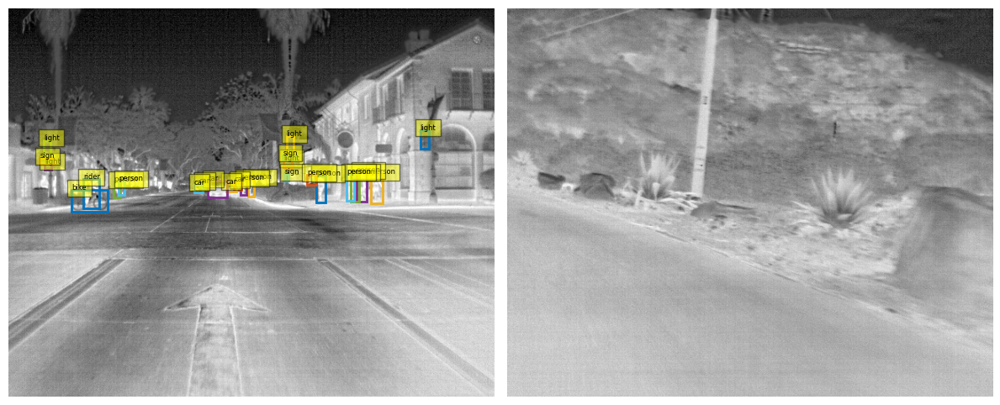

512


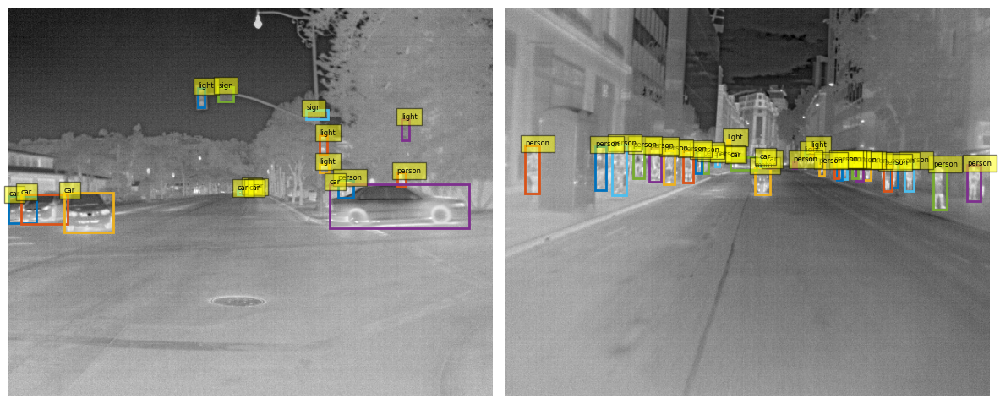

512


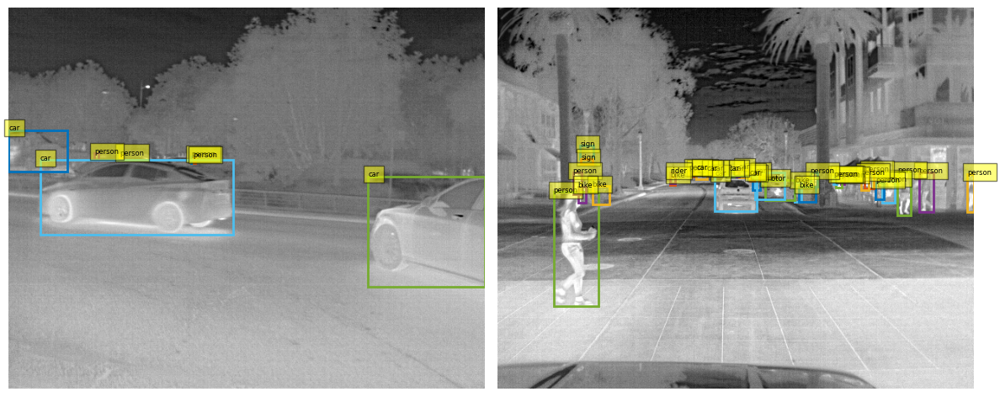

512


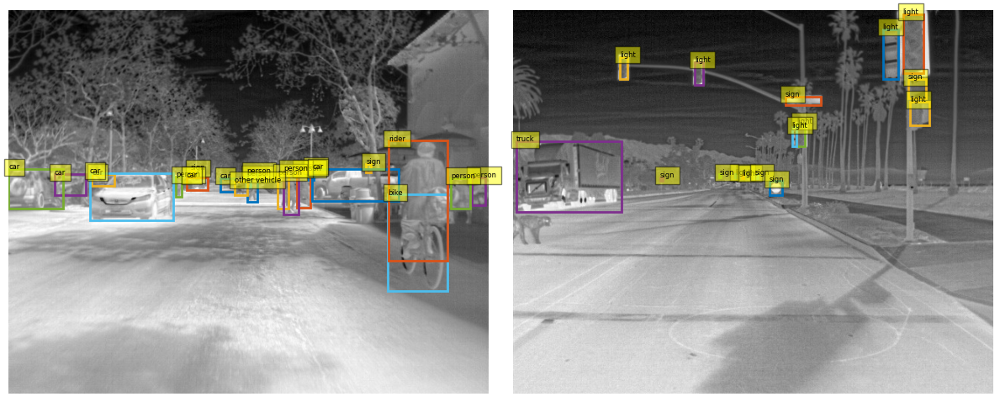

512


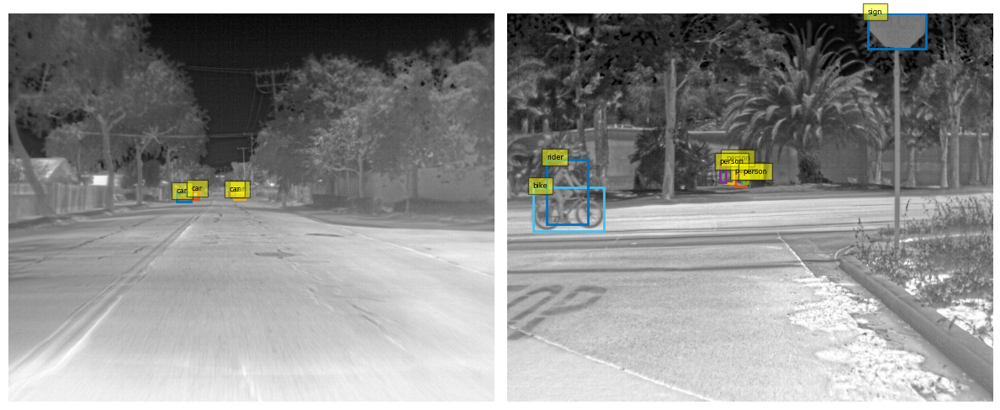

512


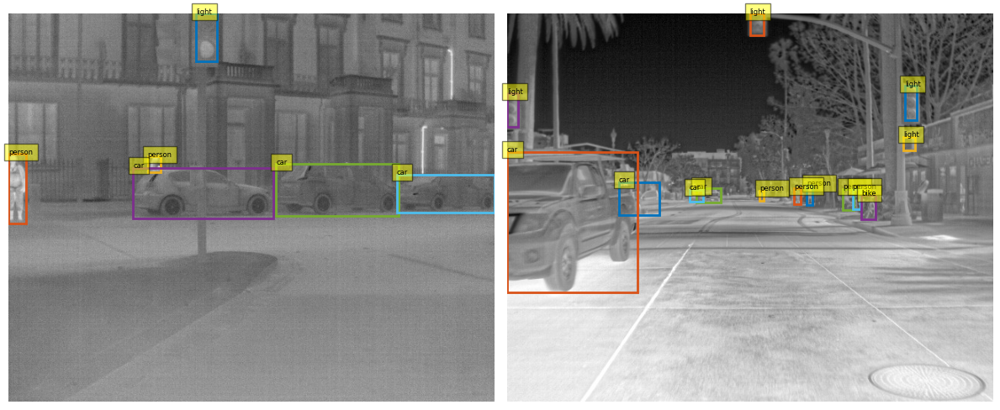

512


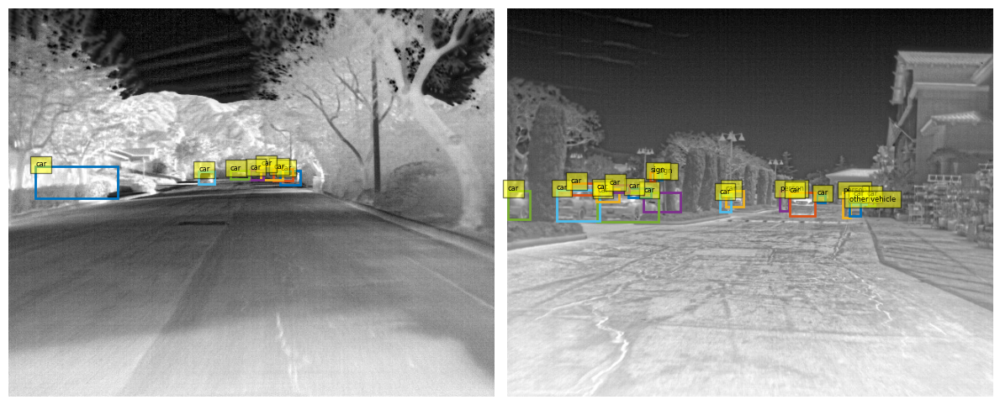

512


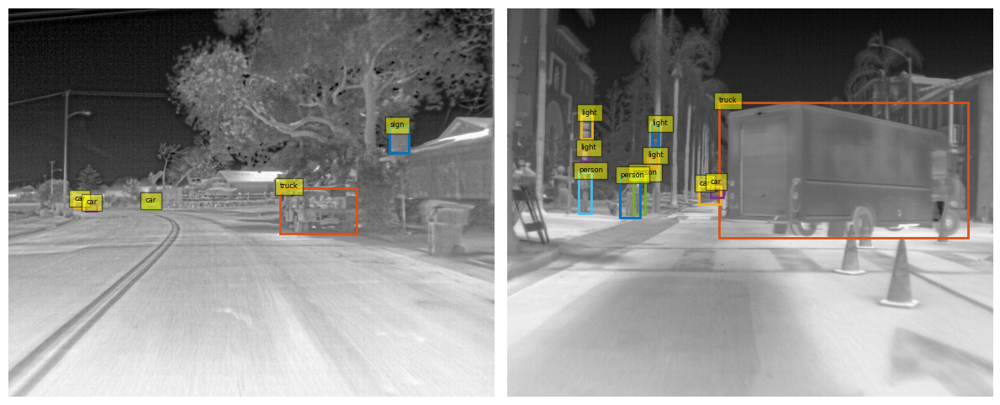

512


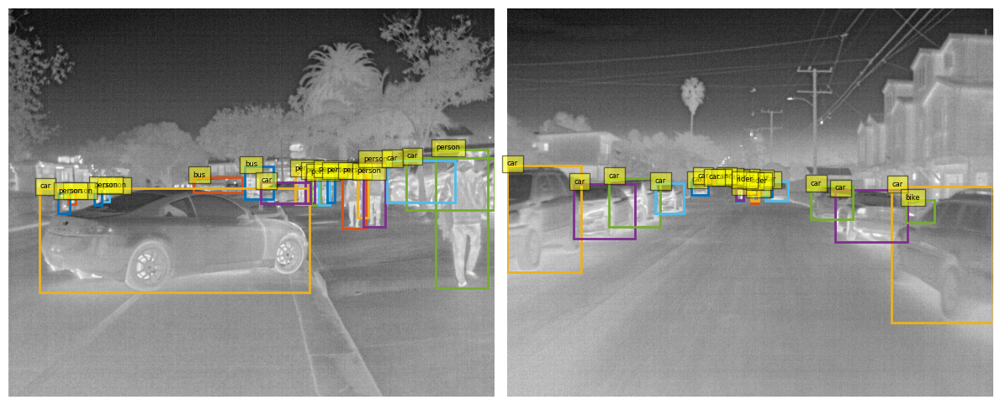

512


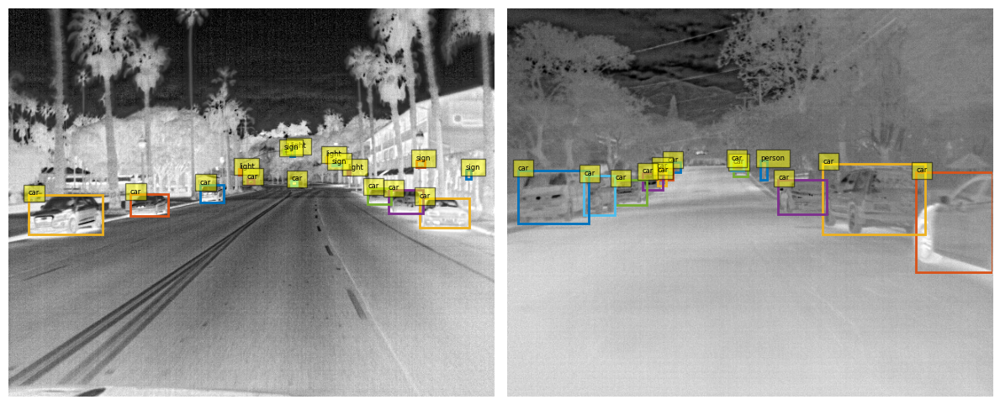

512


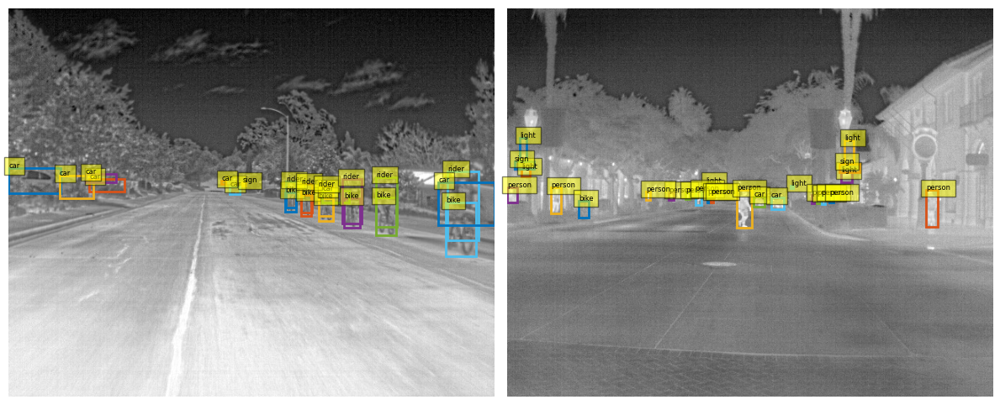

512


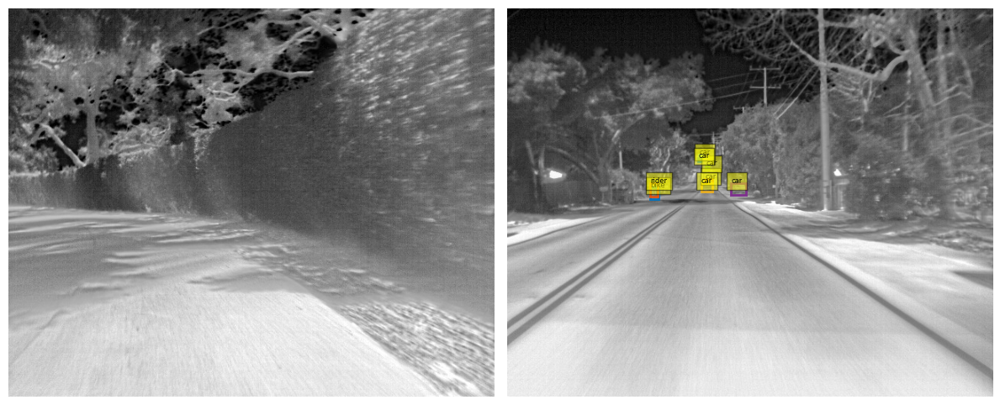

512


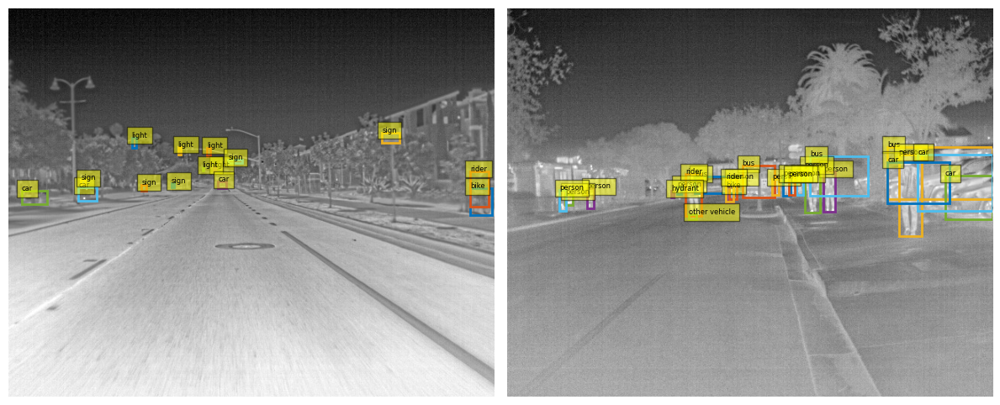

In [10]:
data_path_FLIR_thermal = "data/FLIR/images_thermal_train/"
files = glob.glob('{}data/*'.format(data_path_FLIR_thermal))
annotations_file = '{}index.json'.format(data_path_FLIR_thermal)

with open(annotations_file) as json_file:
    data = json.load(json_file)

annotations = get_annotations(data)

for i in range(20):
    title = random.choice(files)
    frame_id = title.split('-')[-1][:-4]
    image1 = cv2.imread(title)
    print(image1.shape[0])

    fig, axs = plt.subplots(1, 2, figsize=(12, 6))
    axs[0].imshow(image1)
    plot_boxes(axs[0], annotations[frame_id]['labels'], annotations[frame_id]['boxes'])
    axs[0].axis('off')
    
    title = random.choice(files)
    frame_id = title.split('-')[-1][:-4]
    image2 = cv2.cvtColor(cv2.imread(title), cv2.COLOR_BGR2RGB)
    
    axs[1].imshow(image2)
    plot_boxes(axs[1], annotations[frame_id]['labels'], annotations[frame_id]['boxes'])
    axs[1].axis('off')
    
    plt.tight_layout()
    plt.show()

### LLVIP: A Visible-infrared Paired Dataset for Low-light Vision (thermal for object detection)

In [26]:
def get_annotations(annotations_path):
    files = glob.glob('{}/*'.format(annotations_path))
    annotations = {}
    for f in files:
        tree = ET.parse(f)
        root = tree.getroot()
        key = root.find('filename').text
        annotations[key] = {'labels' : [], 'boxes' : []}
        for element in root.iter('object'):
            annotations[key]['labels'].append(element.find('name').text)
            box = element.find('bndbox')
            x_min = int(box.find('xmin').text)
            y_min = int(box.find('ymin').text)
            x_max = int(box.find('xmax').text)
            y_max = int(box.find('ymax').text)
            annotations[key]['boxes'].append((x_min, y_min, x_max, y_max))
    return annotations

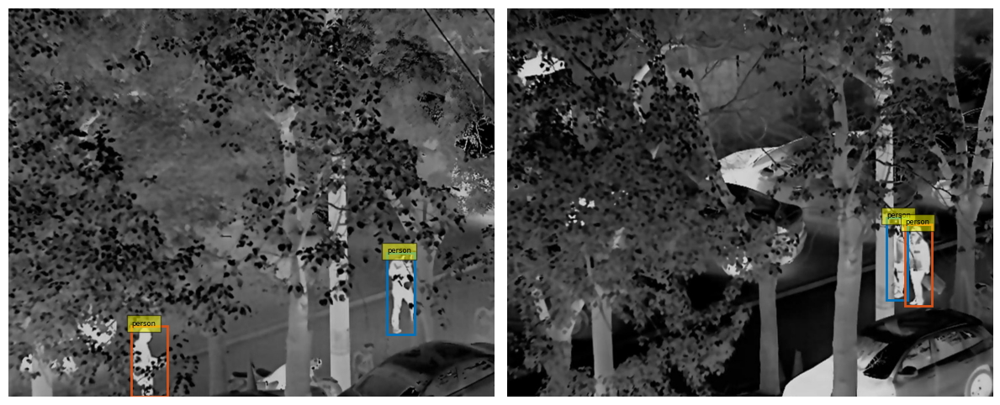

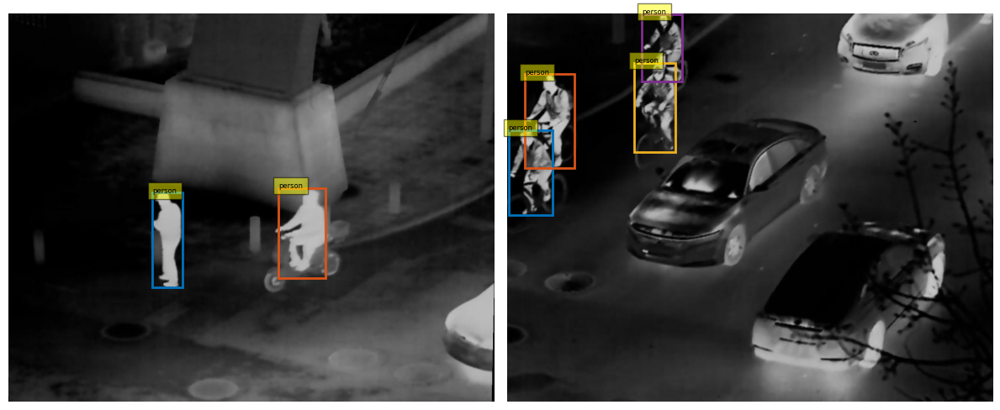

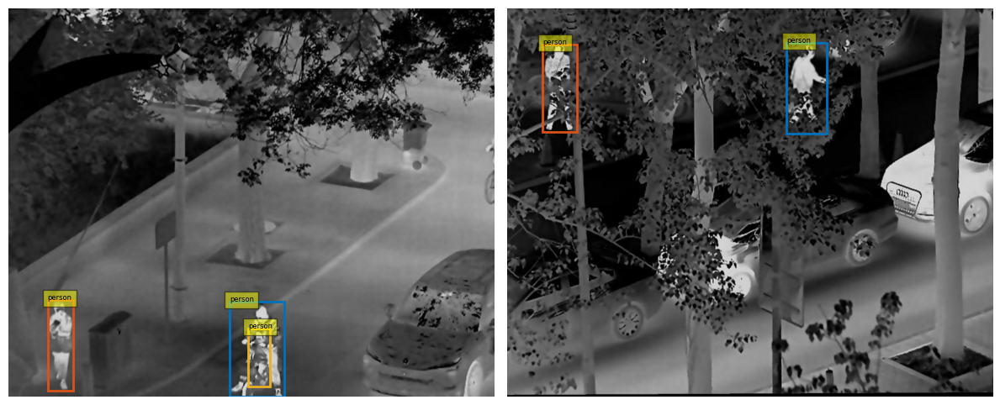

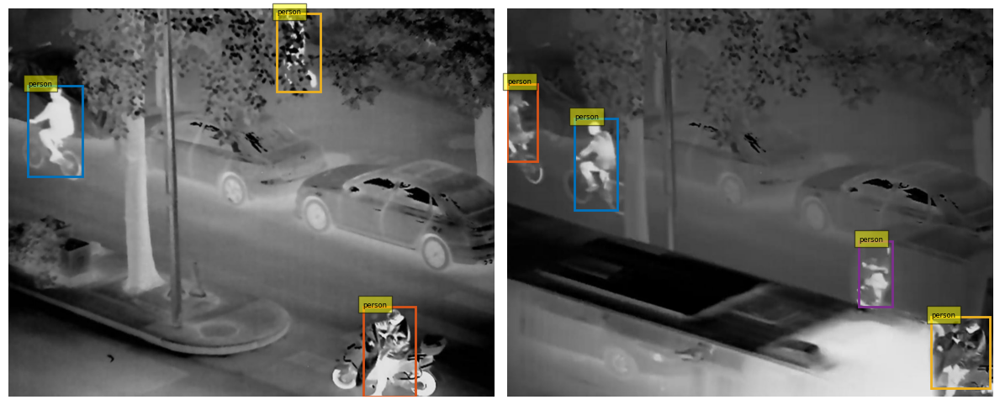

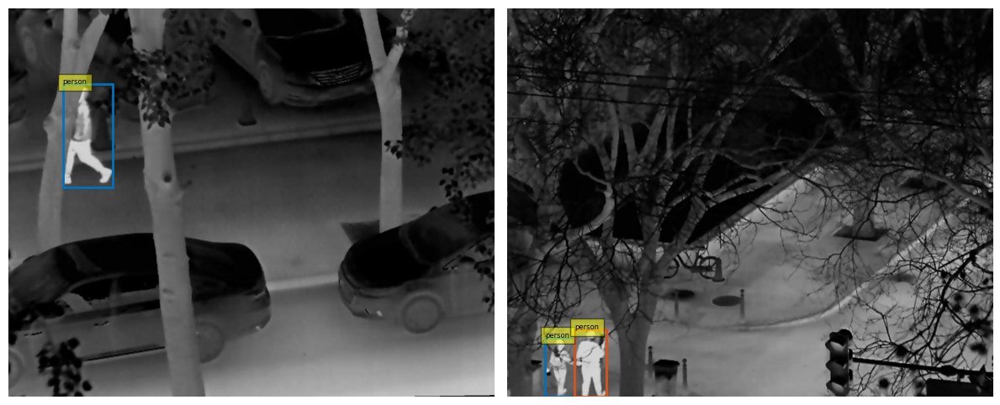

...

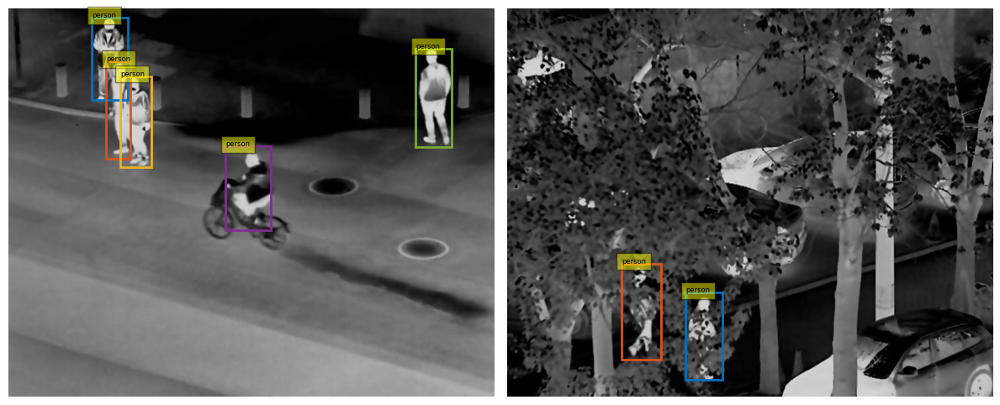

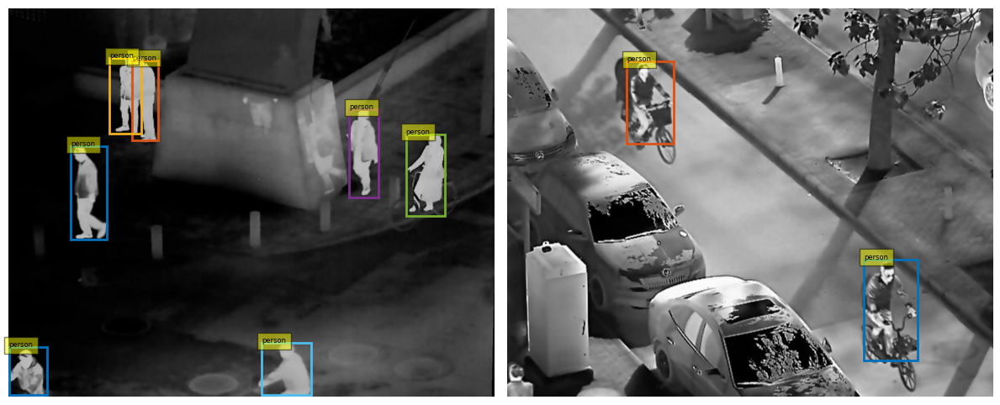

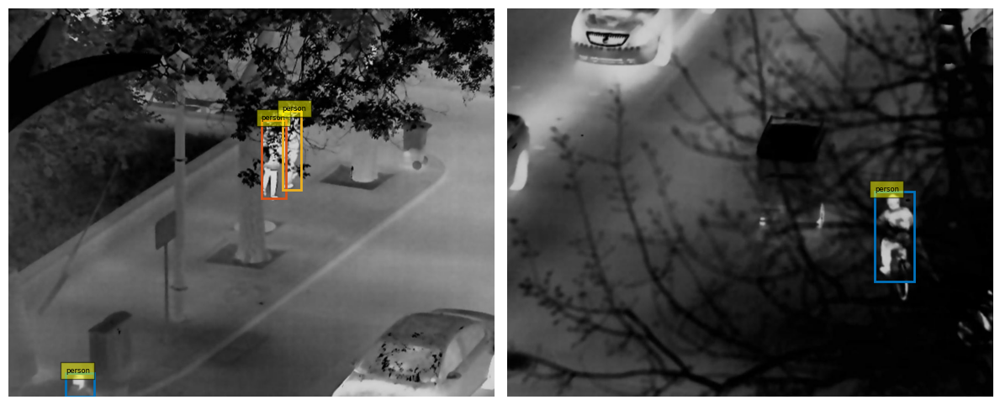

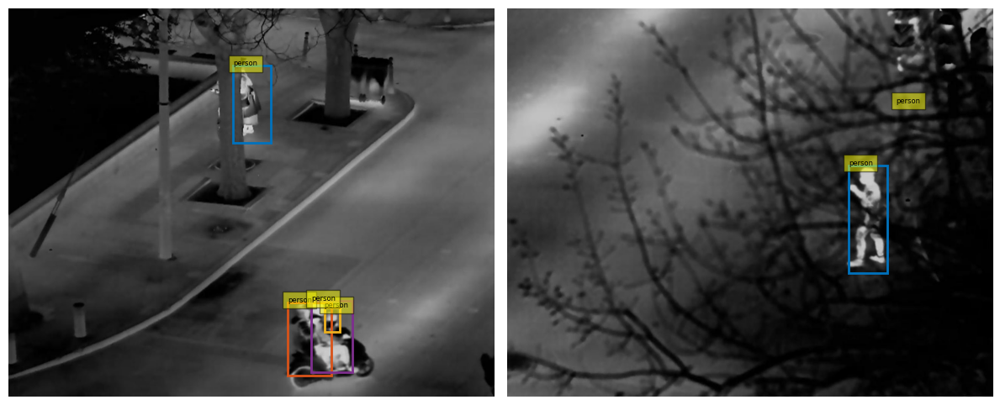

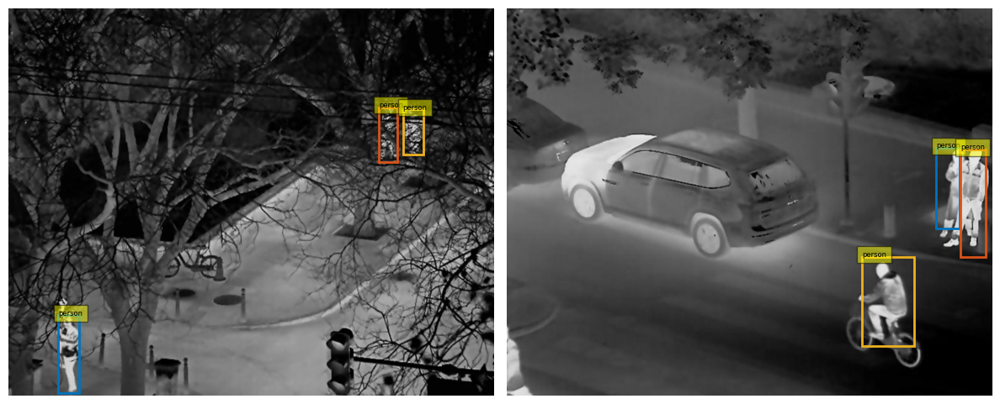

In [27]:
data_path_LLVIP_thermal = "data/LLVIP/"
files = glob.glob('{}infrared/train/*'.format(data_path_LLVIP_thermal))
annotations_path = '{}Annotations'.format(data_path_LLVIP_thermal)

annotations = get_annotations(annotations_path)

for i in range(20):
    title = random.choice(files)
    file = title.split('/')[-1]
    image1 = cv2.imread(title)

    fig, axs = plt.subplots(1, 2, figsize=(12, 6))
    axs[0].imshow(image1)
    plot_boxes(axs[0], annotations[file]['labels'], annotations[file]['boxes'])
    axs[0].axis('off')
    
    title = random.choice(files)
    file = title.split('/')[-1]
    image2 = cv2.cvtColor(cv2.imread(title), cv2.COLOR_BGR2RGB)
    
    axs[1].imshow(image2)
    plot_boxes(axs[1], annotations[file]['labels'], annotations[file]['boxes'])
    axs[1].axis('off')
    
    plt.tight_layout()
    plt.show()

### KAIST Multispectral Pedestrian Detection Benchmark

In [28]:
data_path_KAIST_thermal = "data/KAIST/"
folders = glob.glob('{}annotations/*'.format(data_path_KAIST_thermal))

In [29]:
def get_annotations(annotation_file):
    labels = []
    boxes = []
    tree = ET.parse(annotation_file)
    root = tree.getroot()
    for element in root.iter('object'):
        labels.append(element.find('name').text)
        box = element.find('bndbox')
        x_min = int(box.find('x').text)
        y_min = int(box.find('y').text)
        x_max = x_min + int(box.find('w').text)
        y_max = y_min + int(box.find('h').text)
        boxes.append((x_min, y_min, x_max, y_max))
    return labels, boxes

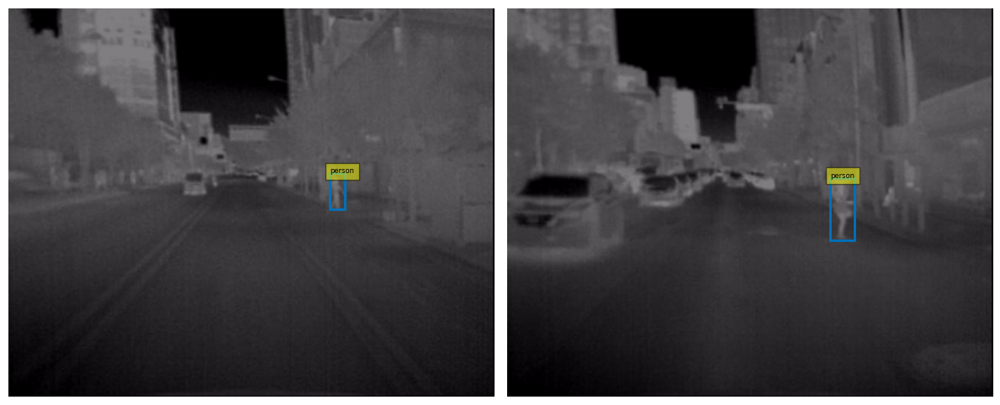

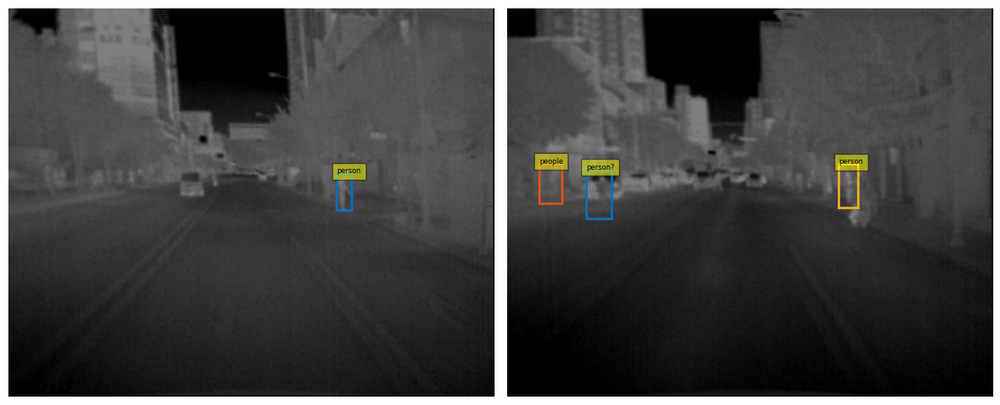

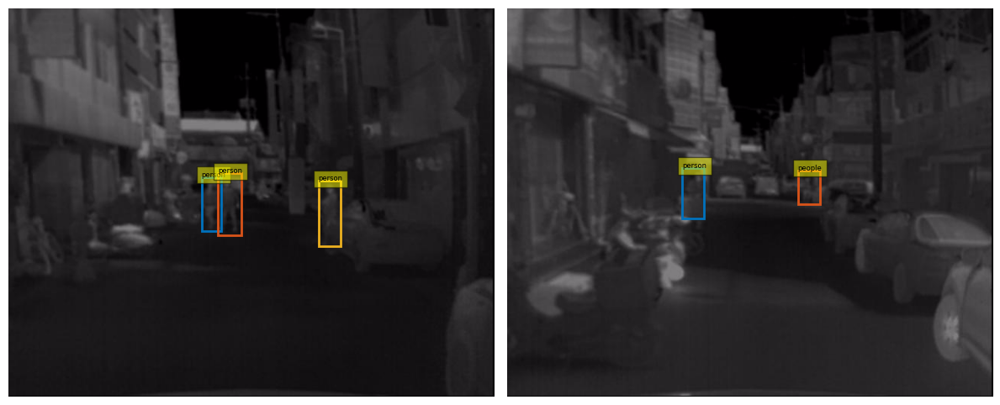

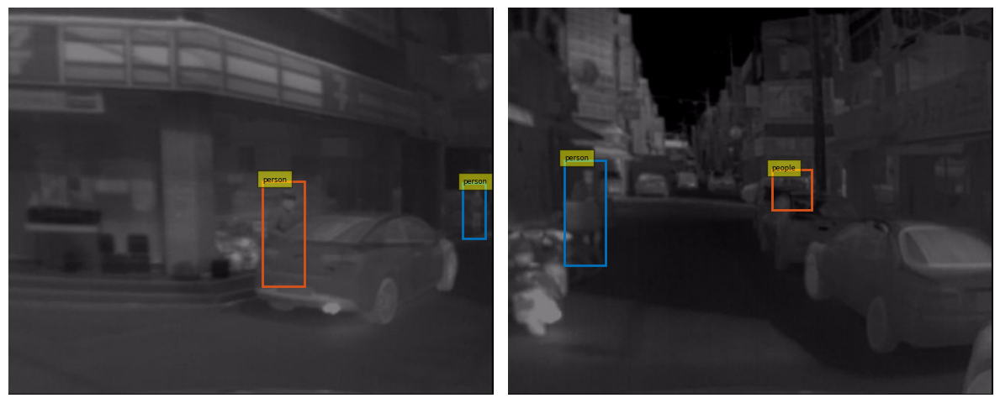

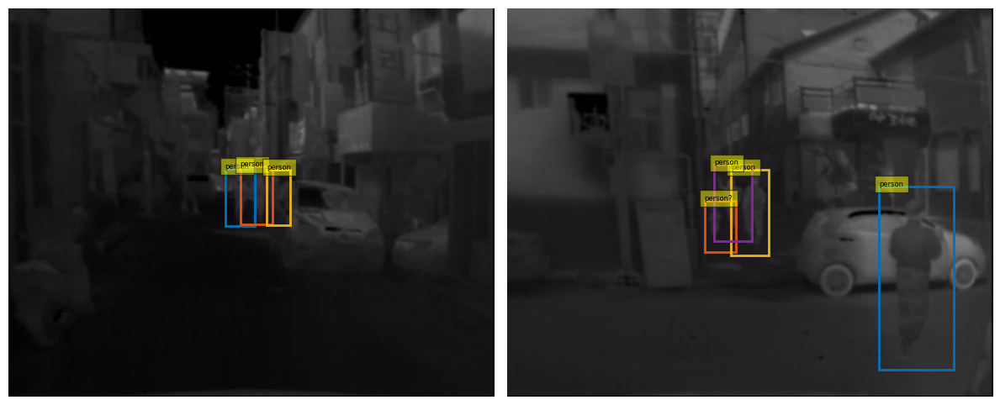

...

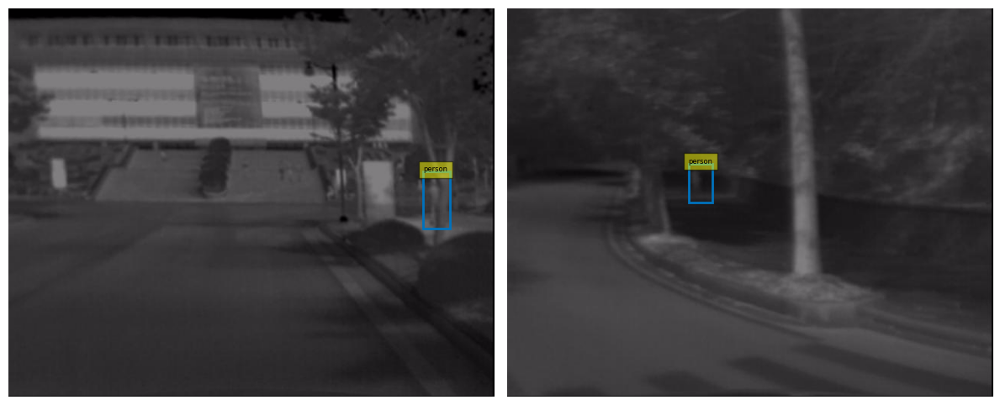

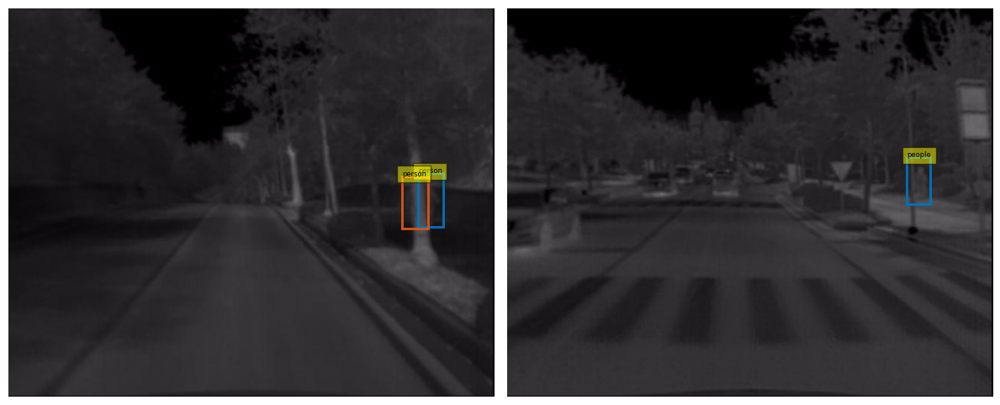

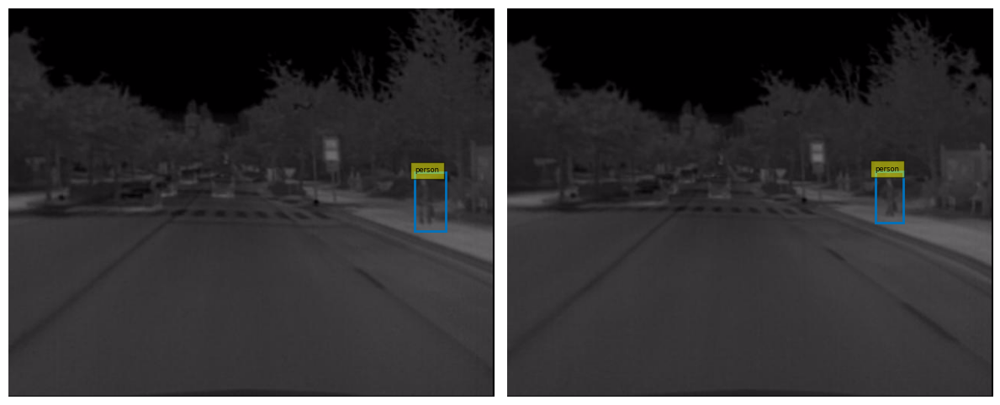

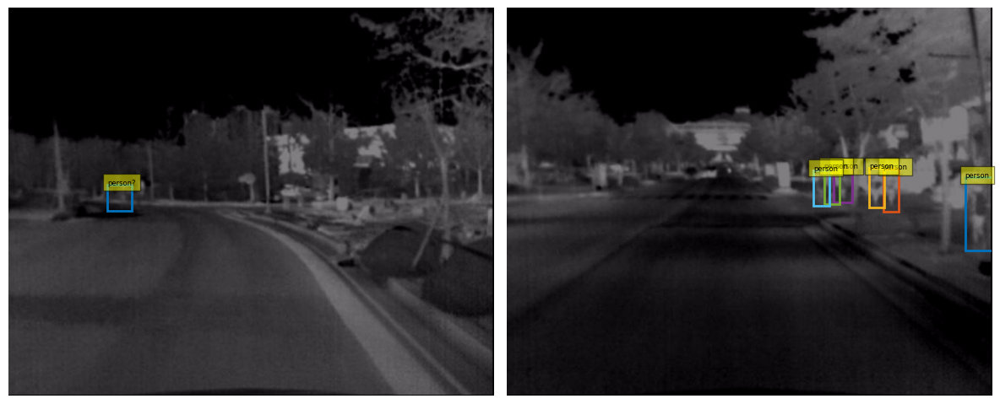

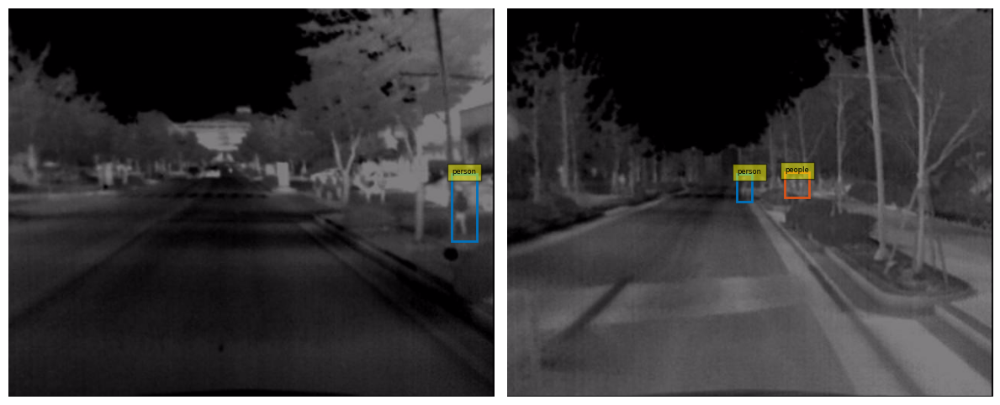

In [30]:
for f in folders:
    sequences = glob.glob('{}/*'.format(f))
    for seq in sequences:
        files = glob.glob('{}/*'.format(seq))
        for i in range(2):
            title = random.choice(files)
            file = title.split('/')
            img_title = 'data/KAIST/images/{}/{}/lwir/{}.jpg'.format(file[3], file[4], file[5].split('.')[0])
            image1 = cv2.imread(img_title)

            fig, axs = plt.subplots(1, 2, figsize=(12, 6))
            axs[0].imshow(image1)
            labels, boxes = get_annotations(title)
            plot_boxes(axs[0], labels, boxes)
            axs[0].axis('off')

            title = random.choice(files)
            file = title.split('/')
            img_title = 'data/KAIST/images/{}/{}/lwir/{}.jpg'.format(file[3], file[4], file[5].split('.')[0])
            image2 = cv2.cvtColor(cv2.imread(img_title), cv2.COLOR_BGR2RGB)

            axs[1].imshow(image2)
            labels, boxes = get_annotations(title)
            plot_boxes(axs[1], labels, boxes)
            axs[1].axis('off')

            plt.tight_layout()
            plt.show()

# Datasets for Tracking

- PTB-TIR (main benchmark)
- VOT-TIR2016  https://cell.missouri.edu/media/publications/Felsberg2016_Chapter_TheThermalInfraredVisualObject.pdf
- TII (1 long sequence for day and 1 long sequence night)

### PTB-TIR

In [34]:
data_path_PTB_TIR_thermal = "data/PTB-TIR/"
sequences = glob.glob('{}*'.format(data_path_PTB_TIR_thermal))
print('Number of sequnces : {}'.format(len(sequences)))
for s in sequences:
    print(s.split('/')[-1])

Number of sequnces : 56
distractor2
soldier
sidewalk2
sidewalk1
school1
road3
crowd3
phone1
park1
crouching
meetion1
airplane
room3
crossroad2
birds
stranger1
meetion3
park2
circle2
campus2
street4
hiding
crowd4
stranger2
street5
school2
street3
phone3
campus1
sandbeach
crossroad1
phone2
classroom3
meetion2
road2
saturated
conversation
street1
fighting
street2
classroom2
road1
meetion4
jacket
crossing
classroom1
room2
stranger3
room1
distractor1
park3
walking
crowd2
circle1
sidewalk3
crowd1


In [49]:
frame_rate = 20

for i in range(3):
    seq = random.choice(sequences)
    files = glob.glob('{}/img/*'.format(seq))
    files = sorted(files)
    output_video = 'ptb-tir_output_video_{}.mp4'.format(i)
    frame = cv2.imread(files[0])
    height, width, _ = frame.shape

    # Create a video writer object
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Use appropriate codec
    video_writer = cv2.VideoWriter(output_video, fourcc, frame_rate, (width, height))

    # Write each frame to the video file
    for f in files:
        frame = cv2.imread(f)
        video_writer.write(frame)

    # Release the video writer
    video_writer.release()
    print(f"Video '{output_video}' has been created.")

Video 'ptb-tir_output_video_0.mp4' has been created.
Video 'ptb-tir_output_video_1.mp4' has been created.
Video 'ptb-tir_output_video_2.mp4' has been created.


### VOT-TIR2016

In [59]:
pip install vot-toolkit

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 167.8/167.8 kB 4.1 MB/s eta 0:00:000:00:01
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.4/62.4 kB 6.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.0/85.0 kB 6.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.3/63.3 kB 7.0 MB/s eta 0:00:00
  Created wheel for vot-toolkit: filename=vot_toolkit-0.6.4-py3-none-any.whl size=194516 sha256=eb3516bbdac9b4f87bad62d990dda0ee06370bf33d973e70cece4efad5ee06dc
  Stored in directory: /home/nadya/.cache/pip/wheels/7d/f9/5f/cf2d08fd380de542d3d55eb1ff5273f319dc8845429a2deb30
  Created wheel for attributee: filename=attributee-0.1.8-py3-none-any.whl size=12858 sha256=af33f26735a25bcdb7bd8ea9ab7818ed3de50c3c0584197f2d0c896d445ea9c7
  Stored in directory: /home/nadya/.cache/pip/wheels/0a/e2/ab/3292c3de25a615

https://www.votchallenge.net/howto/overview.html

### TII

In [57]:
data_path_TII_thermal = "data/TII/night/IR/"
files = glob.glob('{}*'.format(data_path_TII_thermal))
print(len(files))

6494


In [58]:
n = 300
idx = random.choice(range(len(files)-n))
frame_rate = 20

files = sorted(files[idx:idx+n])
output_video = 'tii_output_video.mp4'
frame = cv2.imread(files[0])
height, width, _ = frame.shape

# Create a video writer object
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Use appropriate codec
video_writer = cv2.VideoWriter(output_video, fourcc, frame_rate, (width, height))

# Write each frame to the video file
for f in files:
    frame = cv2.imread(f)
    video_writer.write(frame)

# Release the video writer
video_writer.release()
print(f"Video '{output_video}' has been created.")

Video 'tii_output_video.mp4' has been created.
